  *  https://jakevdp.github.io/PythonDataScienceHandbook/03.11-working-with-time-series.html

In [1]:
!pip install pandas==1.0.0

     |████████████████████████████████| 10.1MB 241kB/s eta 0:00:01
  Found existing installation: pandas 0.24.2
    Uninstalling pandas-0.24.2:
      Successfully uninstalled pandas-0.24.2


In [2]:
!pip install plotly==4.5

     |████████████████████████████████| 7.1MB 6.0MB/s eta 0:00:01
  Found existing installation: plotly 4.4.1
    Uninstalling plotly-4.4.1:
      Successfully uninstalled plotly-4.4.1


In [3]:
!pip install cufflinks

     |████████████████████████████████| 81kB 2.7MB/s eta 0:00:01
     |████████████████████████████████| 81kB 4.3MB/s eta 0:00:011
  Stored in directory: /home/jovyan/.cache/pip/wheels/44/d7/dc/e830ab00bc2dd3b2731295103baa070f8cbdda8891f71a7a8d
Successfully built cufflinks


In [174]:
import pandas as pd
import datetime
import plotly.graph_objs as go
#import plotly.plotly as ply
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot

In [2]:
init_notebook_mode(connected=True)

In [3]:
df_af = pd.read_excel("Africa_1997-2020_Feb08.xlsx")

In [4]:
df_af.head(3)

,ISO,EVENT_ID_CNTY,EVENT_ID_NO_CNTY,EVENT_DATE,YEAR,TIME_PRECISION,EVENT_TYPE,SUB_EVENT_TYPE,ACTOR1,ASSOC_ACTOR_1,...,ADMIN3,LOCATION,LATITUDE,LONGITUDE,GEO_PRECISION,SOURCE,SOURCE_SCALE,NOTES,FATALITIES,TIMESTAMP
0,12,ALG1,1,1997-01-01,1997,1,Violence against civilians,Attack,GIA: Armed Islamic Group,NaN,...,NaN,Douaouda,36.672,2.789,1,Algeria Watch,Other,5 January: Beheading of 5 citizens in Douaouda...,5,1567462135
1,12,ALG2,2,1997-01-02,1997,1,Violence against civilians,Attack,GIA: Armed Islamic Group,NaN,...,NaN,Hassasna,36.133,0.883,1,Algeria Watch,Other,Two citizens were beheaded in Hassasna.,2,1567462135
2,12,ALG3,3,1997-01-03,1997,1,Violence against civilians,Attack,GIA: Armed Islamic Group,NaN,...,NaN,Hassi El Abed,34.966,-0.290,1,Algeria Watch,Other,Two citizens were killed in a raid on the vill...,2,1567462135


In [5]:
df_af["COUNTRY"].unique()

array(['Algeria', 'Angola', 'Botswana', 'Burundi', 'Cameroon',
       'Central African Republic', 'Chad', 'Republic of Congo',
       'Democratic Republic of Congo', 'Benin', 'Equatorial Guinea',
       'Ethiopia', 'Eritrea', 'Djibouti', 'Gabon', 'Gambia', 'Ghana',
       'Guinea', 'Ivory Coast', 'Kenya', 'Lesotho', 'Liberia', 'Libya',
       'Madagascar', 'Malawi', 'Mali', 'Mauritania', 'Morocco',
       'Mozambique', 'Namibia', 'Niger', 'Nigeria', 'Guinea-Bissau',
       'Rwanda', 'Senegal', 'Sierra Leone', 'Somalia', 'South Africa',
       'Zimbabwe', 'South Sudan', 'Sudan', 'eSwatini', 'Togo', 'Tunisia',
       'Uganda', 'Egypt', 'Tanzania', 'Burkina Faso', 'Zambia'],
      dtype=object)

In [6]:
df_af.shape

(202057, 29)

In [7]:
df_af.columns

Index(['ISO', 'EVENT_ID_CNTY', 'EVENT_ID_NO_CNTY', 'EVENT_DATE', 'YEAR',
       'TIME_PRECISION', 'EVENT_TYPE', 'SUB_EVENT_TYPE', 'ACTOR1',
       'ASSOC_ACTOR_1', 'INTER1', 'ACTOR2', 'ASSOC_ACTOR_2', 'INTER2',
       'INTERACTION', 'REGION', 'COUNTRY', 'ADMIN1', 'ADMIN2', 'ADMIN3',
       'LOCATION', 'LATITUDE', 'LONGITUDE', 'GEO_PRECISION', 'SOURCE',
       'SOURCE_SCALE', 'NOTES', 'FATALITIES', 'TIMESTAMP'],
      dtype='object')

In [42]:
df_af.ISO

0          12
161920    729
102494    694
102493    694
102492    694
         ... 
78430     466
62432     404
73035     434
73037     434
107277    694
Name: ISO, Length: 202057, dtype: int64

In [8]:
df_af["EVENT_DATE"] = pd.to_datetime(df_af["EVENT_DATE"])

In [9]:
df_af['EVENT_TYPE'].value_counts()

Battles                       55930
Violence against civilians    50895
Protests                      42758
Riots                         21618
Explosions/Remote violence    16440
Strategic developments        14416
Name: EVENT_TYPE, dtype: int64

In [10]:
df_af["SOURCE_SCALE"].value_counts()

National                     78796
International                31883
Local partner-Other          27564
Regional                     19841
Other                        18680
Subnational                   8445
New media                     4353
National-International        3037
Local partner-New media       2468
National-Regional             1395
New media-National            1083
Regional-International         829
Other-National                 755
Other-Regional                 630
Other-International            602
Subnational-Regional           464
Subnational-National           334
Other-New media                188
National-Other                 185
New media-International        163
New media-Subnational          132
Subnational-International       92
New media-Regional              63
Other-Subnational               30
International-Other             23
Regional-Other                  16
New media-Other                  5
Subnational-Other                1
Name: SOURCE_SCALE, 

In [11]:
regional_cats = ["Regional", 
                 "Other-Regional", 
                 "Subnational", 
                 "Subnationial-Regional", 
                 "Regional-Other", 
                 "Subnational-Other", 
                 "Other-Subnational"]

In [12]:
df_af =  df_af[df_af["SOURCE_SCALE"].isin(regional_cats)]
df_af.shape

(28963, 29)

In [183]:
df_af = df_af.sort_values(by="EVENT_DATE")

df_af_d = df_af.set_index("EVENT_DATE")

df_af_d["EVENT_DATE_MONTH"] = df_af_d.to_period("M").index
df_af_d

,ISO,EVENT_ID_CNTY,EVENT_ID_NO_CNTY,YEAR,TIME_PRECISION,EVENT_TYPE,SUB_EVENT_TYPE,ACTOR1,ASSOC_ACTOR_1,INTER1,...,LOCATION,LATITUDE,LONGITUDE,GEO_PRECISION,SOURCE,SOURCE_SCALE,NOTES,FATALITIES,TIMESTAMP,EVENT_DATE_MONTH
EVENT_DATE,,,,,,,,,,,,,,,,,,,,,
1997-01-01,12,ALG1,1,1997,1,Violence against civilians,Attack,GIA: Armed Islamic Group,NaN,2,...,Douaouda,36.672,2.789,1,Algeria Watch,Other,5 January: Beheading of 5 citizens in Douaouda...,5,1567462135,1997-01
1997-01-01,694,SIE4,4,1997,3,Strategic developments,Looting/property destruction,Kamajor Militia,NaN,3,...,Badjia,7.434,-12.242,2,No Peace Without Justice,Other,Looting,0,1567462217,1997-01
1997-01-01,800,UGA1,1,1997,3,Battles,Armed clash,Military Forces of Uganda (1986-),NaN,1,...,Gulu,2.767,32.306,3,Africa Research Bulletin,Other,Ugandan army battled with LRA rebels - 4 rebel...,4,1567462122,1997-01
1997-01-01,694,SIE5,5,1997,3,Strategic developments,Looting/property destruction,Kamajor Militia,NaN,3,...,Valunia,8.317,-11.734,2,No Peace Without Justice,Other,Looting,0,1567462218,1997-01
1997-01-01,24,ANG1,1,1997,3,Violence against civilians,Attack,UNITA: National Union for the Total Independen...,NaN,2,...,Mumbue,-13.900,17.300,1,Angola Cronologia,National,30 cadavers found October 14,30,1552577681,1997-01
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-02-08,120,CAO2950,2950,2020,1,Battles,Armed clash,Ambazonian Separatists (Cameroon),NaN,2,...,Kumba,4.692,9.210,1,Mimi Mefo,New media,"On 8 Feb. 2020, gunshots were heard in Kumba t...",0,1581370013,2020-02
2020-02-08,120,CAO2948,2948,2020,1,Battles,Armed clash,Ambazonian Separatists (Cameroon),NaN,2,...,Alou,5.157,9.367,1,Mimi Mefo,New media,"On 8 Feb. 2020, Ambazonian separatists engaged...",0,1581370013,2020-02
2020-02-08,120,CAO2952,2952,2020,1,Strategic developments,Looting/property destruction,Ambazonian Separatists (Cameroon),NaN,2,...,Limbe,4.024,9.215,1,Mimi Mefo,New media,"On 8 Feb. 2020, Ambazonian separatists attacke...",0,1581370013,2020-02


In [185]:
df_af_d.unstack().T.unstack().unstack().reset_index(level=[0,1])

ValueError: Index contains duplicate entries, cannot reshape

In [41]:
df_af_m_new = df_af_m_new.reset_index()

In [48]:
df_af_m_new

,EVENT_TYPE,EVENT_DATE_MONTH,COUNTRY,0
0,Battles,1997-01,Algeria,8.0
1,Explosions/Remote violence,1997-01,Algeria,11.0
2,Protests,1997-01,Algeria,0.0
3,Riots,1997-01,Algeria,0.0
4,Strategic developments,1997-01,Algeria,0.0
...,...,...,...,...
81727,Explosions/Remote violence,2020-02,eSwatini,NaN
81728,Protests,2020-02,eSwatini,NaN
81729,Riots,2020-02,eSwatini,NaN
81730,Strategic developments,2020-02,eSwatini,NaN


In [16]:
#min_year = df_af["EVENT_DATE"].min().year
min_year=2000
max_year = df_af["EVENT_DATE"].max().year

In [17]:
len_years= len(list(range(int(min_year),int(max_year)+1)))


In [18]:
fa_arr = [False]*len_years

In [19]:
annot_year_dict = {}
data = []
updatemenus_buttons = []
for index,year in enumerate(range(int(min_year), int(max_year)+1)):
    year_arr = [False]*len_years
    year_arr[index] = True
    
    data.append(go.Scatter(x=list(df_af_d[df_af_d["EVENT_DATE_YEAR"]==str(year)].index),
                        y=list(df_af_d[df_af_d["EVENT_DATE_YEAR"]==str(year)]["FATALITIES"]),
                        name=str(year),
                        line=dict(color='#33CFA5')))
    
    annot_year_dict[str(year)]=[dict(x=df_af_d.index,
                           y=df_af_d[df_af_d["EVENT_DATE_YEAR"]==str(year)]["FATALITIES"].mean(),
                           xref='x', yref='y',
                           text="Mean Fatilities",
                           ax=0, ay=-40)]
    
    updatemenus_buttons.append(dict(label=str(year),
                                    method = 'update',
                                    args = [{'visible':year_arr,
                                             'title': str(year),
                                             'annocations':annot_year_dict[str(year)]}]))
    

updatemenus_buttons.append(dict(label="All",
                                    method = 'update',
                                    args = [{'visible':[True]*len_years,
                                             'title': "All",
                                             'annocations':[]}]))
    
    
updatemenus = list([dict(active=1,
                         buttons=list(updatemenus_buttons))])


In [ ]:

layout = dict(title='Regional Crisis Fatalities in Africa per Year', showlegend=False,
              updatemenus=updatemenus,
              xaxis_rangeslider_visible=True)

fig = dict(data=data, layout=layout)

                  
iplot(fig, filename='update_dropdown')

### Plot with all

In [ ]:
'''
import plotly.graph_objects as go
import pandas as pd

fig = go.Figure()
fig.add_trace(go.Scatter(x=df_af["EVENT_DATE"], 
                         y=df_af['FATALITIES'], 
                         name="FATALITIES",
                         mode="markers"),
                         marker=dict(
                            color='LightSkyBlue',
                            size=20,
            line=dict(
                color='MediumPurple',
                width=2
            )
        ),                       )


#fig.add_trace(go.Scatter(x=df.Date, y=df['AAPL.Low'], name="AAPL Low",
#                        line_color='dimgray'))

fig.update_layout(title_text='Time Series with Rangeslider',
                  xaxis_rangeslider_visible=True)
fig.show()
'''

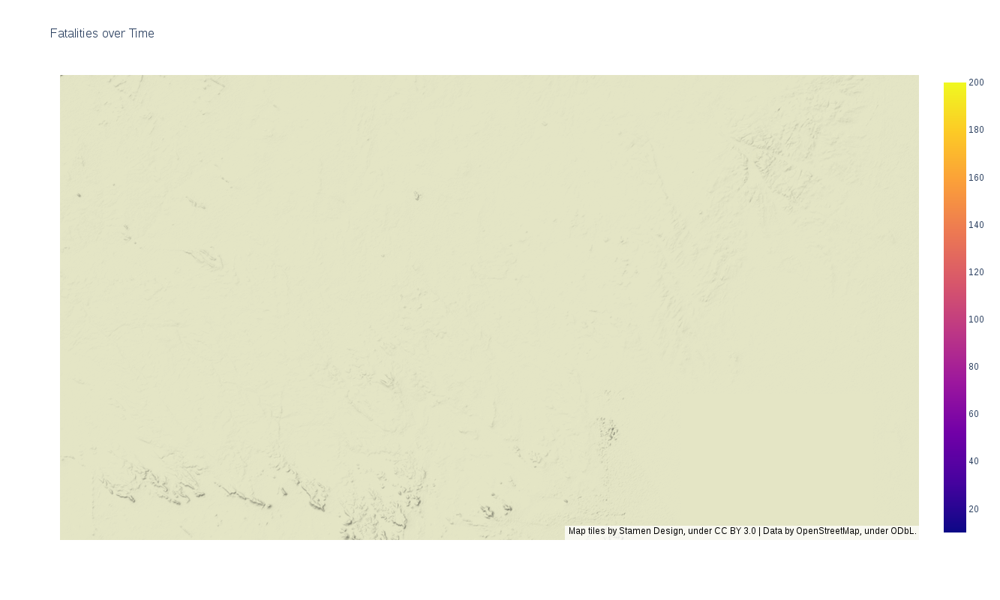

In [186]:
# drawing the plot with Scattermapbox which is a plot type that is exclusively for visualizing geospatial data
fig = go.Figure(data=go.Scattermapbox(
    lat = df_af_d['LATITUDE'],
    lon = df_af_d['LONGITUDE'],
    text="Fatalities:"+df_af_d['FATALITIES'].astype(str), 
    marker=dict(
            size=8,
            showscale=True,
            color=df_af_d['FATALITIES'].astype(int),
            cmin=10,
            cmax=200,
            opacity= 0.5,
           
           
            ),
    
    ),
)

fig.update_layout(
        title = 'Fatalities over Time',
        width = 1300,
        height = 800,
     
        mapbox = {
            'center': {'lon': 8.789063, 'lat': 20.780772},
            'style': "stamen-terrain",
            'zoom': 9},
       
)


fig.show()


In [17]:
df_af_d_2000 = df_af_d[df_af_d.YEAR >= 2015]

In [18]:
df_af_d_2000.head()

,ISO,EVENT_ID_CNTY,EVENT_ID_NO_CNTY,YEAR,TIME_PRECISION,EVENT_TYPE,SUB_EVENT_TYPE,ACTOR1,ASSOC_ACTOR_1,INTER1,...,LOCATION,LATITUDE,LONGITUDE,GEO_PRECISION,SOURCE,SOURCE_SCALE,NOTES,FATALITIES,TIMESTAMP,EVENT_DATE_MONTH
EVENT_DATE,,,,,,,,,,,,,,,,,,,,,
2015-01-01,706,SOM16580,16580,2015,1,Battles,Armed clash,Military Forces of Somalia (2012-2017),NaN,1,...,Xudur,4.121,43.888,1,Undisclosed Source,Local partner-Other,Al Shabaab fighters launched a hit and run att...,0,1571260148,2015-01
2015-01-01,706,SOM16581,16581,2015,1,Battles,Armed clash,AMISOM: African Union Mission in Somalia (2007-),Military Forces of Somalia (2012-2017),8,...,Buur Weyn,3.590,45.560,1,Undisclosed Source,Local partner-Other,Al Shabaab fighters carried out an ambush agai...,1,1571260148,2015-01
2015-01-01,706,SOM16583,16583,2015,1,Battles,Armed clash,AMISOM: African Union Mission in Somalia (2007...,NaN,8,...,Yoontoy Yarey,-0.130,42.574,1,Radio Risala,National,Al Shabaab and AMISOM-Kenya clash in Yoontoy Y...,0,1572403772,2015-01
2015-01-01,140,CEN2718,2718,2015,2,Violence against civilians,Attack,Anti-Balaka,NaN,3,...,Kolo,7.237,18.075,1,RCA (Central African Republic),National,"In Kolo village, Anti-Balaka bury alive a woma...",2,1567462240,2015-01
2015-01-01,108,BUR3026,3026,2015,1,Riots,Mob violence,Rioters (Burundi),Unidentified Communal Group (Burundi),5,...,Kayanza,-2.922,29.629,3,Radio Publique Africaine,National,"Followers of Euzebie, ""who claims to have seen...",0,1567462237,2015-01


In [19]:
df_af_d_2000["EVENT_DATE_MONTH"] = df_af_d_2000.to_period("M").index

/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [ ]:


import plotly.graph_objects as go

# drawing the plot with Scattermapbox which is a plot type that is exclusively for visualizing geospatial data
fig = go.Figure(data=go.Scattermapbox(
    lat = df_af_d_2000['LATITUDE'],
    lon = df_af_d_2000['LONGITUDE'],
    text="Fatalities:"+df_af_d_2000['FATALITIES'].astype(str), 
    marker=dict(
            size=8,
            showscale=True,
            color=df_af_d['FATALITIES'].astype(int),
            cmin=10,
            cmax=200,
            opacity= 0.5,
           
           
            ),
    
    ),
)

lats = list(df_af_d_2000['LATITUDE'])
lons = list(df_af_d_2000['LONGITUDE'])


frames = [dict(data= [dict(type='scattermapbox',
                           lat=lats[:k+1],
                           lon=lons[:k+1])],
               traces= [0],
               name='frame{}'.format(k)       
              )for k in  range(1, len(df_af_d_2000))]      



sliders = [dict(steps= [dict(method= 'animate',
                           args= [[ 'frame{}'.format(k) ],
                                  dict(mode= 'immediate',
                                  frame= dict( duration=100, redraw= True ),
                                           transition=dict( duration= 0)
                                          )
                                    ],
                            label='{:d}'.format(k)
                             ) for k in range(len(df_af_d_2000))], 
                transition= dict(duration= 0 ),
                x=0,#slider starting position  
                y=0, 
                currentvalue=dict(font=dict(size=12), 
                                  prefix='Point: ', 
                                  visible=True, 
                                  xanchor= 'center'),  
                len=1.0)
           ]


# update Layout to add title define the plot size and define the map focus and zoom level
fig.update_layout(
        title = 'Fatalities over Time',
        width = 1300,
        height = 800,
     
        mapbox = {
            'center': {'lon': 8.789063, 'lat': 20.780772},
            'style': "stamen-terrain",
            'zoom': 9}, sliders=sliders
       
)


fig.show()


  * https://openweathermap.org/history
  * https://github.com/johan/world.geo.json

In [14]:
import json

In [15]:
with open('countries.geo.json') as json_file:
    world_geo = json.load(json_file)

In [ ]:
world_geo

In [ ]:
# drawing the plot with Scattermapbox which is a plot type that is exclusively for visualizing geospatial data
fig = go.Figure(data=go.Scattermapbox(
    lat = df_af_d['LATITUDE'],
    lon = df_af_d['LONGITUDE'],
    text="Fatalities:"+df_af_d['FATALITIES'].astype(str), 
    marker=dict(
            size=8,
            showscale=True,
            color=df_af_d['FATALITIES'].astype(int),
            cmin=10,
            cmax=200,
            opacity= 0.5,
           
           
            ),
    
    ),
)

fig.update_layout(
        title = 'Fatalities over Time',
        width = 1300,
        height = 800,
     
        mapbox = {
            'center': {'lon': 8.789063, 'lat': 20.780772},
            'style': "stamen-terrain",
            'zoom': 3,
            'layers': [{
            'source': world_geo,
            'type': "fill", 'below': "traces", 'color': "royalblue", "opacity": .30,
}]},
    margin = {'l':0, 'r':0, 'b':0, 't':0})

fig.show()


In [63]:
df_acled.head()

,Unnamed: 0,EVENT_DATE_MONTH,COUNTRY,Battles,Explosions/Remote violence,Protests,Riots,Strategic developments,Violence against civilians,FATALITIES,YEAR,"Life expectancy at birth, total (years)",GDP (current US$),"Death rate, crude (per 1,000 people)",Population growth (annual %),Urban population (% of total),"Central government, Fiscal Balance (Current US $)","Population, Total"
0,0,1997-01,Algeria,8.0,11.0,0.0,0.0,0.0,23.0,465,1997,68.932,4.817786e+10,5.400,1.617981,58.425744,1.457813e+09,29887717.0
1,1,1997-01,Angola,0.0,0.0,0.0,0.0,1.0,3.0,40,1997,43.088,7.074393e+09,21.350,2.808642,28.051572,-1.616077e+09,13801868.0
2,2,1997-01,Burundi,9.0,0.0,0.0,0.0,2.0,8.0,796,1997,50.176,1.194241e+09,15.428,1.373382,7.558006,-6.224048e+07,6420397.0
3,3,1997-01,Central African Republic,6.0,0.0,0.0,0.0,0.0,1.0,14,1997,45.867,9.445119e+08,18.364,2.362984,36.611405,1.620297e+07,3497910.0
4,4,1997-01,Democratic Republic of Congo,16.0,1.0,0.0,0.0,0.0,3.0,992,1997,0.000,0.000000e+00,0.000,0.000000,0.000000,0.000000e+00,0.0


In [ ]:
world_geo

In [23]:
world_geo

mapbox_access_token = "pk.eyJ1IjoicGxvdGx5bWFwYm94IiwiYSI6ImNqdnBvNDMyaTAxYzkzeW5ubWdpZ2VjbmMifQ.TXcBE-xg9BFdV2ocecc_7g"
mapbox_style = "mapbox://styles/plotlymapbox/cjvprkf3t1kns1cqjxuxmwixz"


In [43]:
count = pd.read_csv('countries_codes_and_coordinates.csv')

In [85]:
count.Country.unique()

array(['Afghanistan', 'Albania', 'Algeria', 'American Samoa', 'Andorra',
       'Angola', 'Anguilla', 'Antarctica', 'Antigua and Barbuda',
       'Argentina', 'Armenia', 'Aruba', 'Australia', 'Austria',
       'Azerbaijan', 'Bahamas', 'Bahrain', 'Bangladesh', 'Barbados',
       'Belarus', 'Belgium', 'Belize', 'Benin', 'Bermuda', 'Bhutan',
       'Bolivia, Plurinational State of', 'Bolivia',
       'Bosnia and Herzegovina', 'Botswana', 'Bouvet Island', 'Brazil',
       'British Indian Ocean Territory', 'Brunei Darussalam', 'Brunei',
       'Bulgaria', 'Burkina Faso', 'Burundi', 'Cambodia', 'Cameroon',
       'Canada', 'Cape Verde', 'Cayman Islands',
       'Central African Republic', 'Chad', 'Chile', 'China',
       'Christmas Island', 'Cocos (Keeling) Islands', 'Colombia',
       'Comoros', 'Congo', 'Congo, the Democratic Republic of the',
       'Cook Islands', 'Costa Rica', "Côte d'Ivoire", 'Ivory Coast',
       'Croatia', 'Cuba', 'Cyprus', 'Czech Republic', 'Denmark',
       'Djibou

In [56]:
count['alpha3'] = count['Alpha-3 code'].str.replace('"','')


In [60]:
count['numcode'] = count['Numeric code'].str.replace('"','').astype(int)

In [73]:
def addiso3(row):
    row_d = row.to_dict()
    try:
        row_d['iso3'] = count[count["Country"] == row['COUNTRY']]["alpha3"].values[0]
    except:
        row_d['iso3'] = ''
    return pd.Series(row_d)

In [75]:
df_acled = df_acled.apply(addiso3, axis=1)

In [84]:
df_acled[df_acled.iso3 == ''].COUNTRY.unique()

array(['Democratic Republic of Congo', 'Republic of Congo', 'eSwatini',
       'Tanzania', 'South Sudan'], dtype=object)

In [103]:
df_acled.loc[df_acled[df_acled.COUNTRY == 'Democratic Republic of Congo'].index,'iso3'] = "COD"

In [104]:
df_acled.loc[df_acled[df_acled.COUNTRY == 'Republic of Congo'].index,'iso3'] = "COG"

In [105]:
df_acled.loc[df_acled[df_acled.COUNTRY == 'eSwatini'].index,'iso3'] = "SWZ"

In [106]:
df_acled.loc[df_acled[df_acled.COUNTRY == 'Tanzania'].index,'iso3'] = "TZA"

In [107]:
df_acled.loc[df_acled[df_acled.COUNTRY == 'South Sudan'].index,'iso3'] = "SSD"

In [114]:
df_acled["iso3"] = df_acled["iso3"].str.strip()

In [115]:
df_acled.to_csv("acled_social_iso3.csv")

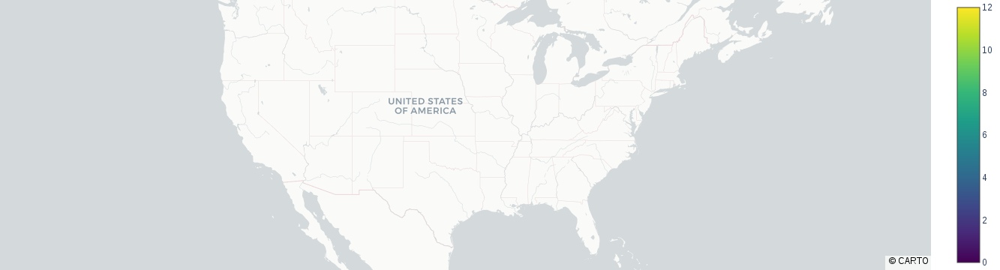

In [82]:

fig = go.Figure(go.Choroplethmapbox(geojson=world_geo, locations=df_acled["iso3"], z=df_acled["FATALITIES"],
                                    colorscale="Viridis", zmin=0, zmax=12,
                                    marker_opacity=0.5, marker_line_width=0))
fig.update_layout(mapbox_style="carto-positron",
                  mapbox_zoom=3, mapbox_center = {"lat": 37.0902, "lon": -95.7129})
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()


In [ ]:
import plotly.express as px

map0 = go.Choroplethmapbox( geojson=world_geo, locations=df_acled["COUNTRY"],
                            z=df_acled["FATALITIES"],
                           marker_opacity=0.5,
                      
                          )

layout = go.Layout(
    title = {'text': 'TIDE Hackathon Predicting Crisis',
    		 'font': {'size':28, 
    		 		  'family':'Arial'}},
    autosize = True,
    
    mapbox1 = dict(
        domain = {'x': [0.3, 1],'y': [0, 1]},
        center = dict(lat=20.780772, lon=8.789063),
        accesstoken = mapbox_access_token, 
        zoom = 3),

    xaxis2={
        'zeroline': False,
        "showline": False,
        "showticklabels":True,
        'showgrid':True,
        'domain': [0, 0.25],
        'side': 'left',
        'anchor': 'x2',
    },
    yaxis2={
        'domain': [0.4, 0.9],
        'anchor': 'y2',
        'autorange': 'reversed',
    },
    margin=dict(l=100, r=20, t=70, b=70),
    paper_bgcolor='rgb(204, 204, 204)',
    plot_bgcolor='rgb(204, 204, 204)',
)

fig=go.Figure(data=[map0],layout=layout)
fig.show()

In [17]:
df_acled = pd.read_csv('acled_social.csv')

In [ ]:
import plotly.express as px

fig = px.choropleth_mapbox(df_acled, geojson=world_geo, locations="iso3",color='FATALITIES',
                           color_continuous_scale="Viridis", 
                           range_color=(0, 12),
                           mapbox_style="carto-positron",
                           zoom=3, center = {'lon': 8.789063, 'lat': 20.780772},
                           opacity=0.5,
                      
                          )

sliders = [dict(steps= [dict(method= 'restyle',
                           args= [[ 'frame{}'.format(k) ],
                                  dict(mode= 'immediate',
                                  frame= dict( duration=100, redraw= True ),
                                           transition=dict( duration= 0)
                                          )
                                    ],
                            label=k
                             ) for k in df_acled['EVENT_DATE_MONTH'].to_list()], 
                transition= dict(duration= 0 ),
                x=0,#slider starting position  
                y=0, 
                currentvalue=dict(font=dict(size=12), 
                                  prefix='Point: ', 
                                  visible=True, 
                                  xanchor= 'center'),  
                len=1.0)
           ]


# update Layout to add title define the plot size and define the map focus and zoom level
fig.update_layout(
        title = 'Fatalities over Time',
        width = 1300,
        height = 800,
     
        mapbox = {
            'center': {'lon': 8.789063, 'lat': 20.780772},
            'style': "stamen-terrain",
            'zoom': 3}, sliders=sliders
       
)



fig.show()



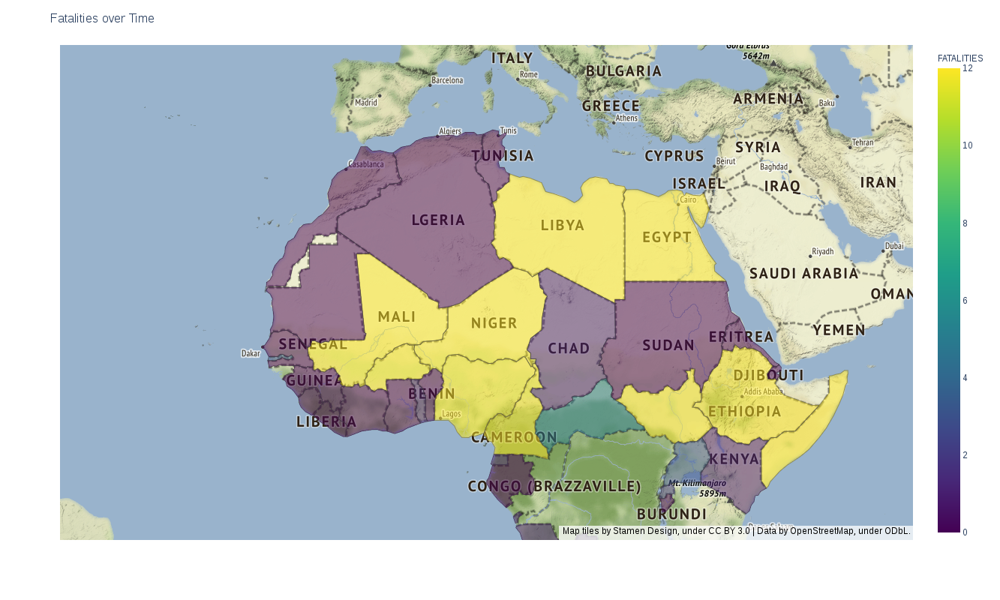

In [93]:
import plotly.express as px

fig = px.choropleth_mapbox(df_acled, geojson=world_geo, locations="COUNTRY",color='FATALITIES',
                           color_continuous_scale="Viridis", featureidkey='properties.name',
                           range_color=(0, 12),
                           mapbox_style="carto-positron",
                           zoom=3, center = {'lon': 8.789063, 'lat': 20.780772},
                           opacity=0.5,
                      
                          )

fig.update_layout(
        title = 'Fatalities over Time',
        width = 1300,
        height = 800,
     
        mapbox = {
            'center': {'lon': 8.789063, 'lat': 20.780772},
            'style': "stamen-terrain",
            'zoom': 3})

fig.show()

In [112]:
df_acled.iso3.unique()

array([' DZA', ' AGO', ' BDI', ' CAF', 'COD', ' EGY', ' ETH', ' CIV',
       ' KEN', ' LBR', ' LBY', ' MLI', ' MAR', ' NAM', ' NER', ' NGA',
       'COG', ' RWA', ' SLE', ' ZAF', ' SDN', ' TGO', ' UGA', ' BFA',
       ' CMR', ' TCD', ' ERI', ' LSO', ' SOM', 'SWZ', ' GHA', ' MRT',
       ' SEN', ' ZMB', ' GNB', ' MWI', ' ZWE', ' MOZ', ' GMB', 'TZA',
       ' GNQ', ' MDG', ' GAB', ' DJI', ' BEN', ' BWA', ' GIN', ' TUN',
       'SSD'], dtype=object)

In [111]:
for val in world_geo['features']:
    print(val['id'])
    break

AFG


In [118]:
          
MONTHS = list(df_acled.EVENT_DATE_MONTH.unique())

MONTH_LIST = list(range(len(MONTHS)))

In [ ]:
MONTH_LIST

In [121]:
df_acled["EVENT_DATE_MONTH"]

0       1997-01
1       1997-01
2       1997-01
3       1997-01
4       1997-01
         ...   
8768    2020-02
8769    2020-02
8770    2020-02
8771    2020-02
8772    2020-02
Name: EVENT_DATE_MONTH, Length: 8773, dtype: object

In [134]:
list(range(0,20000,1000))

[0,
 1000,
 2000,
 3000,
 4000,
 5000,
 6000,
 7000,
 8000,
 9000,
 10000,
 11000,
 12000,
 13000,
 14000,
 15000,
 16000,
 17000,
 18000,
 19000]

In [139]:
df_acled['FATALITIES']

0       465
1        40
2       796
3        14
4       992
       ... 
8768      0
8769      0
8770      3
8771      2
8772      0
Name: FATALITIES, Length: 8773, dtype: int64

In [149]:
fat_bins = list(range(0,20000,1000))
labels = [str(x) for x in fat_bins[1:]]
df_acled["FAT_bin"] = pd.cut(df_acled['FATALITIES'], bins, labels=labels)
df_acled["FAT_bin"] = df_acled["FAT_bin"].cat.add_categories("< 1000")
df_acled["FAT_bin"].fillna("< 1000")

0         1000
1         1000
2         1000
3         1000
4         1000
         ...  
8768    < 1000
8769    < 1000
8770      1000
8771      1000
8772    < 1000
Name: FAT_bin, Length: 8773, dtype: category
Categories (20, object): [1000 < 2000 < 3000 < 4000 ... 17000 < 18000 < 19000 < < 1000]

In [148]:
df_acled.to_csv("acled_social_iso3.csv")

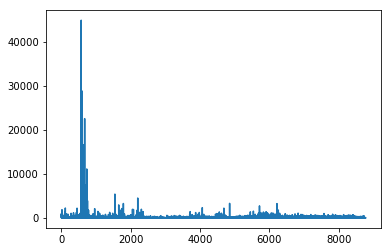

In [125]:
df_acled["FATALITIES"].plot()

In [155]:
df_acled[(df_acled["iso3"] == "COG") & (df_acled["EVENT_DATE_MONTH"] == "1997-01")]["FATALITIES"].values[0]

12

In [156]:
iso3_list = list(df_acled.iso3.unique())


In [158]:
for val in world_geo['features']:
    if val['id'] in iso3_list:
            try:
                value = df_acled[(df_acled["iso3"] == val["id"]) & (df_acled["EVENT_DATE_MONTH"] == "1997-01")]["FATALITIES"].values[0]
            except:
                value = 0
            print(value)

40
796
0
0
0
14
2
0
992
12
0
465
6
0
0
0
0
0
0
0
0
6
0
8
0
0
0
0
0
0
0
0
15
11
146
1860
0
0
40
0
0
0
0
0
0
16
4
0
0


In [160]:
from matplotlib import cm
from matplotlib import colors
from scipy import interpolate

In [163]:
cat_interpol = interpolate.interp1d([0, len(labels)], [0,1])
labels = ["bla"] + labels

In [164]:
for i, val in enumerate(labels):
    print(colors.to_hex(cm.get_cmap("rainbow")(cat_interpol(i))))

#8000ff
#6629fe
#4c50fc
#3079f7
#169bf2
#07bbea
#20d5e1
#3dead5
#56f7ca
#72febb
#8cfead
#a8f79c
#c2ea8c
#ded579
#f9bb66
#ff9b52
#ff793e
#ff5029
#ff2914
#ff0000


In [ ]:
df_acled["FAT_bin"] = pd.cut(df_acled['FATALITIES'], fat_bins, labels=labels)
df_acled["FAT_bin"] = df_acled["FAT_bin"].cat.add_categories("< 100")
df_acled["FAT_bin"].fillna("< 100", inplace=True)
df_acled["FAT_bin"] = df_acled["FAT_bin"].replace("", "< 100")
labels = ["< 100"] + labels

In [165]:
df_acled.columns

Index(['Unnamed: 0', 'EVENT_DATE_MONTH', 'COUNTRY', 'Battles',
       'Explosions/Remote violence', 'Protests', 'Riots',
       'Strategic developments', 'Violence against civilians', 'FATALITIES',
       'YEAR', 'Life expectancy at birth, total (years)', 'GDP (current US$)',
       'Death rate, crude (per 1,000 people)', 'Population growth (annual %)',
       'Urban population (% of total)',
       'Central government, Fiscal Balance (Current US $)',
       'Population, Total', 'iso3', 'FAT_bin'],
      dtype='object')

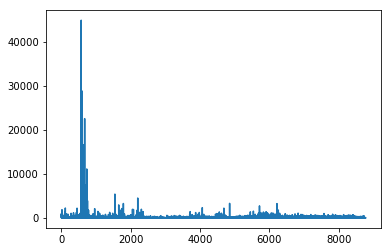

In [172]:
df_acled["FATALITIES"].plot()

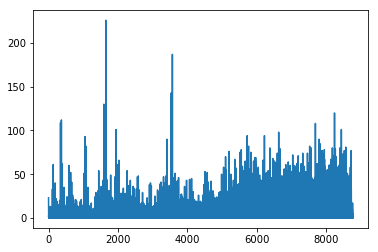

In [173]:
df_acled["Violence against civilians"].plot()

In [180]:
fig = go.Figure([go.Scatter(x=df_acled['EVENT_DATE_MONTH'], y=df_acled["Violence against civilians"])])
print(fig["layout"]["title"])

layout.Title()
